# 📖 Asha and the Friendly Stars

**Scene 1** — Asha loves the night sky. A tiny comet named Nova twinkles hello. “Let’s visit friendly stars!” Asha says.

**Scene 2** — They land on the Echo Hills, where whispers bounce. Shy star sprites hide. Asha waves kindly while Nova glows gentle and calm.

**Scene 3** — On the Cloud Playground, a puff bridge is torn. Asha listens to each cloud. Together, they fluff a soft path for all.

**Scene 4** — Next, a puzzle planet needs help. Moon kids can’t lift big star pieces alone. Asha shares a plan, and everyone works as a team.

**Scene 5** — On the Singing Stones, the beat is strong. Asha shares snacks and starts a circle dance. New friends clap along.

**Scene 6** — Time to head home. The stars sparkle a smiling pattern. “Kindness makes light,” Asha whispers as Nova zips a happy loop.

## 🎨 Generating illustrations…

[Scene 1] Generating…


**Scene 1** — Asha loves the night sky. A tiny comet named Nova twinkles hello. “Let’s visit friendly stars!” Asha says.

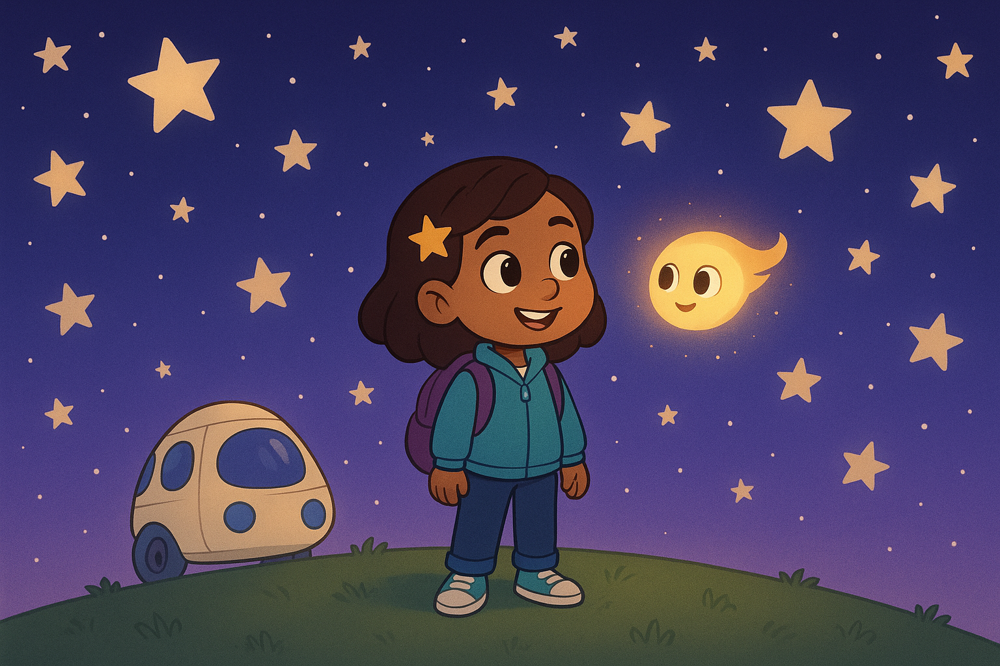

*Alt text:* Asha meets Nova under a starry sky, smiling and ready for a kind space adventure.

[Scene 2] Generating…


**Scene 2** — They land on the Echo Hills, where whispers bounce. Shy star sprites hide. Asha waves kindly while Nova glows gentle and calm.

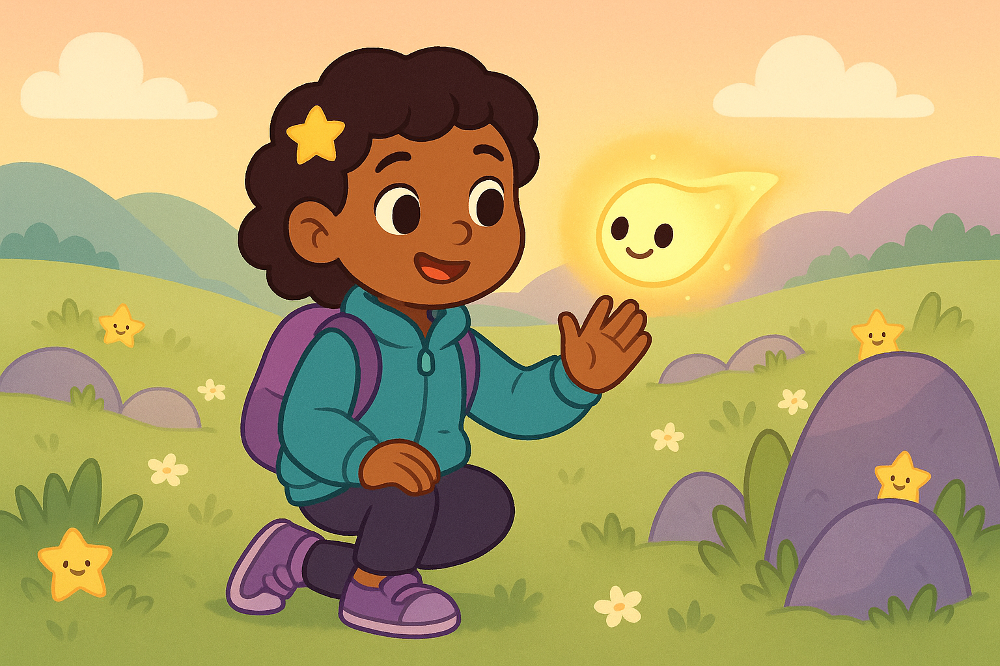

*Alt text:* Asha and Nova greet shy star sprites on pastel echoing hills with friendly smiles.

[Scene 3] Generating…


**Scene 3** — On the Cloud Playground, a puff bridge is torn. Asha listens to each cloud. Together, they fluff a soft path for all.

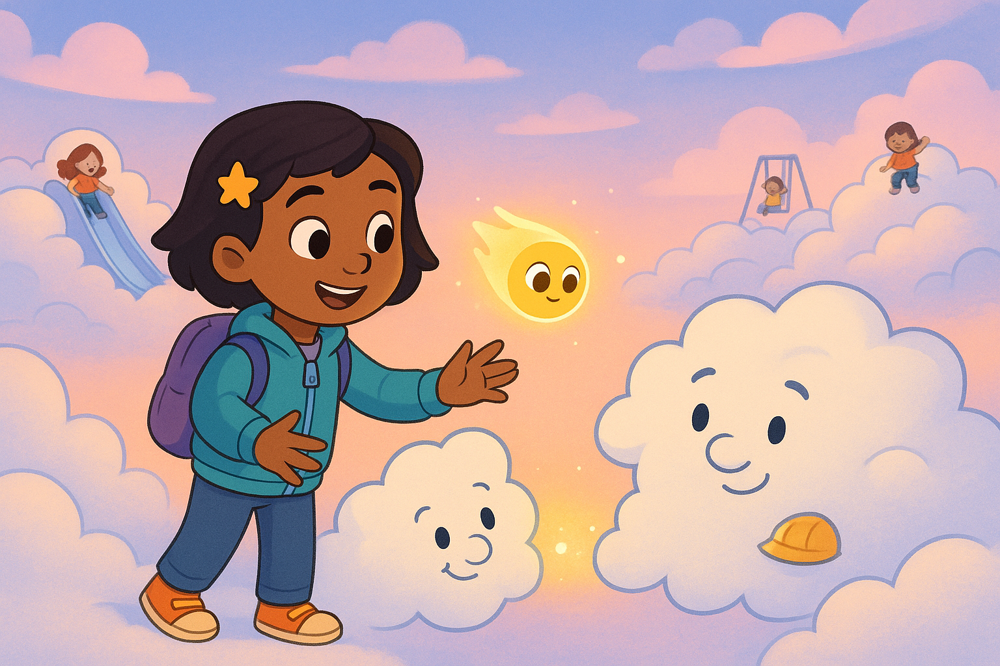

*Alt text:* Asha helps friendly clouds reconnect a puffy bridge while Nova glows nearby.

[Scene 4] Generating…


**Scene 4** — Next, a puzzle planet needs help. Moon kids can’t lift big star pieces alone. Asha shares a plan, and everyone works as a team.

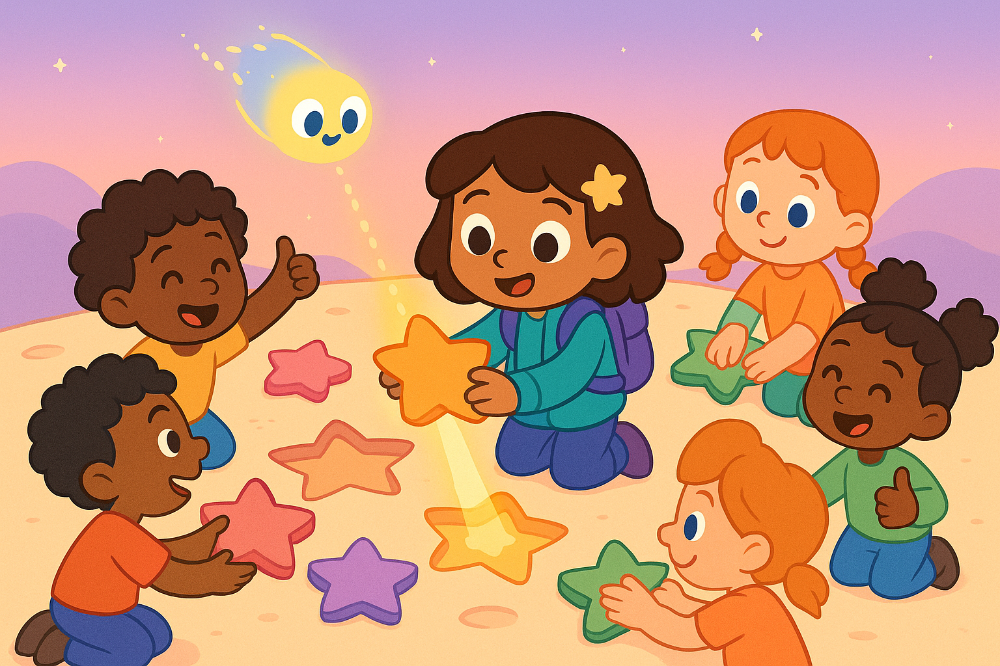

*Alt text:* Asha and diverse moon kids fit big star tiles together as Nova lights the next spot.

[Scene 5] Generating…


**Scene 5** — On the Singing Stones, the beat is strong. Asha shares snacks and starts a circle dance. New friends clap along.

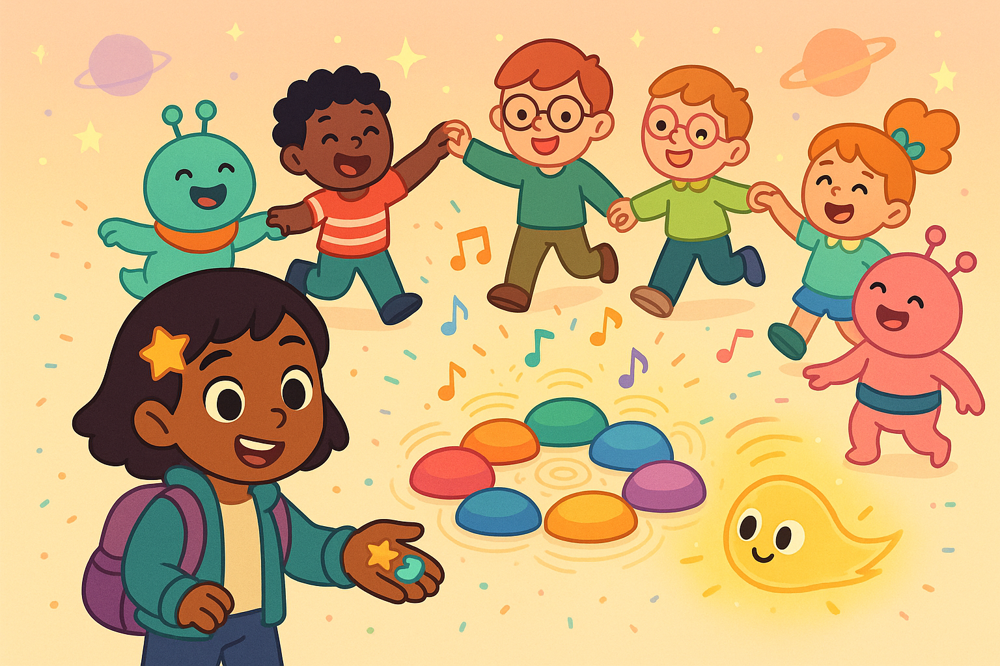

*Alt text:* Asha shares snacks and dances with new friends on musical stones as Nova pulses to the beat.

[Scene 6] Generating…


**Scene 6** — Time to head home. The stars sparkle a smiling pattern. “Kindness makes light,” Asha whispers as Nova zips a happy loop.

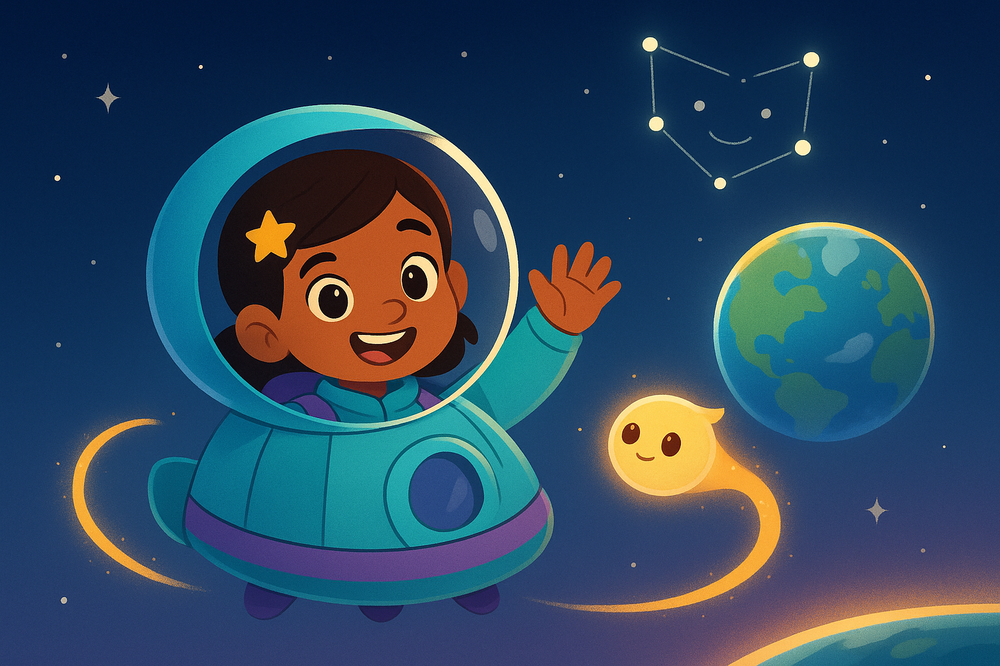

*Alt text:* Asha and Nova wave near home as stars form a smiling constellation in the sky.


Saved 6 panels in storyboard/ and zipped to storyboard.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# ✅ CHILD-SAFE STORYBOARD + IMAGE GENERATION WITH GPT-5 (Google Colab)
# - Writes a children's story as structured JSON
# - Generates one illustration per scene using the image_generation tool
# - Displays and downloads each panel image
# - Falls back gracefully if a moderation block occurs

!pip -q install --upgrade openai Pillow

import os, json, base64, time, re
from io import BytesIO
from PIL import Image
from IPython.display import display, Markdown
from google.colab import files
from openai import OpenAI
from openai import BadRequestError  # available in latest SDK

# 🔑 Set your key: either set env var in Colab sidebar or edit below
# os.environ["OPENAI_API_KEY"] = "sk-..."
OPENAI_API_KEY = "your-open-ai-key"



client = OpenAI(api_key=OPENAI_API_KEY)

# ---------- CONFIG ----------
TITLE = "Asha and the Friendly Stars"
NUM_SCENES = 6
SAFE_STYLE = (
    "Children's book illustration, 2D cartoon, bright and cheerful, "
    "friendly expressions, diverse cast, fully clothed, non-violent, "
    "no brands or logos, no licensed characters, age-appropriate, "
    "clean background, storybook composition"
)
CHARACTER_BIBLE = (
    "Main character: Asha, a curious young space explorer with a teal jacket, "
    "purple backpack, and a star-shaped hair clip. Companion: Nova, a tiny "
    "glowing comet buddy with big round eyes. Consistent design across scenes."
)

THEME = "Learning kindness and teamwork while exploring imaginative planets."

# ---------- 1) ASK GPT-5 FOR A STRUCTURED STORYBOARD ----------
story_prompt = f"""
You are a children's author and art director. Create a kid-safe storyboard for a short
children's picture-book adventure.

Requirements:
- Title: "{TITLE}"
- Theme: {THEME}
- {NUM_SCENES} scenes (panels) total.
- Language: Simple, warm, age 5–8 reading level.
- Each scene must include:
  1) "panel_text": 1–3 short sentences that an adult could read aloud to a child.
  2) "image_prompt": an *art-director* prompt for an illustration tool.
     MUST include: "{SAFE_STYLE}" and the design bible: "{CHARACTER_BIBLE}".
     Avoid any brands, logos, or licensed characters. No scary content.
  3) "alt_text": concise accessible alt text (<= 160 chars).

Output STRICT valid JSON with this schema:
{{
  "title": "string",
  "scenes": [
    {{
      "id": 1,
      "panel_text": "string",
      "image_prompt": "string",
      "alt_text": "string"
    }}
  ]
}}
Return only JSON. No extra prose.
"""

resp = client.responses.create(
    model="gpt-5",
    input=story_prompt,
)

def extract_text(r):
    # Works across current Responses API shapes
    if hasattr(r, "output_text") and r.output_text:
        return r.output_text
    chunks = []
    for o in getattr(r, "output", []):
        if getattr(o, "type", "") == "message":
            for c in getattr(o, "content", []):
                if getattr(c, "type", "") == "output_text" or getattr(c, "type","")=="text":
                    t = getattr(c, "text", "")
                    if t:
                        chunks.append(t)
    return "\n".join(chunks).strip()

raw_json = extract_text(resp)
try:
    storyboard = json.loads(raw_json)
except json.JSONDecodeError:
    # Try to recover JSON if the model wrapped it in fences or extra text
    json_str = raw_json
    m = re.search(r"\{[\s\S]*\}", raw_json)
    if m:
        json_str = m.group(0)
    storyboard = json.loads(json_str)

title = storyboard.get("title", TITLE).strip() or TITLE
scenes = storyboard["scenes"][:NUM_SCENES]

display(Markdown(f"# 📖 {title}"))
for sc in scenes:
    display(Markdown(f"**Scene {sc['id']}** — {sc['panel_text']}"))

# ---------- 2) GENERATE IMAGES FOR EACH SCENE ----------
def safeify(prompt: str) -> str:
    """Ensure safety/style tags are present and avoid sensitive terms."""
    core = prompt.strip()
    # Guarantee our safety/style constraints are reinforced
    tags = (
        f"{SAFE_STYLE}. {CHARACTER_BIBLE}. "
        "Wholesome, uplifting, gentle humor, inclusive, cozy lighting, "
        "no realism, no photorealism, no suggestive content."
    )
    merged = f"{tags} {core}"
    # Reduce terms that sometimes get over-filtered; prefer 'kid-friendly' / 'storybook'
    merged = merged.replace("realistic", "storybook").replace("photo", "illustration")
    return merged

def generate_image_b64(image_prompt: str, retry=1):
    """Call image generation tool. If moderation blocks, try once with a safer prompt."""
    try:
        gen = client.responses.create(
            model="gpt-5",
            input=image_prompt,
            tools=[{"type": "image_generation"}],
        )
        # Extract the first image_generation_call result
        image_data = [
            o.result for o in getattr(gen, "output", [])
            if getattr(o, "type", "") == "image_generation_call"
        ]
        if not image_data:
            raise RuntimeError("No image data returned.")
        return image_data[0]  # base64 string
    except BadRequestError as e:
        msg = str(e)
        if "moderation_blocked" in msg and retry > 0:
            # Auto-rephrase: remove potential triggers, amp up cartoon cues
            safer = (
                "Cartoon, children’s-book illustration only. "
                "No brands, no licensed characters, fully clothed, wholesome. "
            ) + image_prompt
            time.sleep(0.8)
            return generate_image_b64(safer, retry=retry-1)
        raise

os.makedirs("storyboard", exist_ok=True)
generated_files = []

display(Markdown("## 🎨 Generating illustrations…"))

for sc in scenes:
    scene_id = sc["id"]
    panel_text = sc["panel_text"]
    img_prompt = safeify(sc["image_prompt"])
    alt_text = sc.get("alt_text", f"Scene {scene_id} illustration.")

    print(f"[Scene {scene_id}] Generating…")
    b64 = generate_image_b64(img_prompt, retry=1)

    img_bytes = base64.b64decode(b64)
    img = Image.open(BytesIO(img_bytes)).convert("RGB")

    fname = f"storyboard/scene_{scene_id:02d}.png"
    img.save(fname, format="PNG")
    generated_files.append(fname)

    display(Markdown(f"**Scene {scene_id}** — {panel_text}"))
    display(img)
    display(Markdown(f"*Alt text:* {alt_text}"))

# ---------- 3) DOWNLOAD AS A ZIP ----------
import zipfile
zip_path = "storyboard.zip"
with zipfile.ZipFile(zip_path, "w", zipfile.ZIP_DEFLATED) as zf:
    for f in generated_files:
        zf.write(f, arcname=os.path.basename(f))

print(f"\nSaved {len(generated_files)} panels in storyboard/ and zipped to {zip_path}")
files.download(zip_path)


In [ ]:
!pip -q install moviepy

from moviepy.editor import ImageClip, concatenate_videoclips

# Adjust how long each panel is shown (seconds)
DURATION_PER_PANEL = 3

clips = []
for f in generated_files:  # from your storyboard code
    clip = ImageClip(f).set_duration(DURATION_PER_PANEL)
    clips.append(clip)

# Concatenate into one video
video = concatenate_videoclips(clips, method="compose")
video_path = "story_animation.mp4"
video.write_videofile(video_path, fps=24)

from google.colab import files
files.download(video_path)


  if event.key is 'enter':



Moviepy - Building video story_animation.mp4.
Moviepy - Writing video story_animation.mp4



Moviepy - Done !
Moviepy - video ready story_animation.mp4


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!pip install -q gtts moviepy pydub

from gtts import gTTS
from moviepy.editor import VideoFileClip, concatenate_audioclips, AudioFileClip
from pydub import AudioSegment
import os

# Example panel texts from your storyboard, in order matching generated_files
panel_texts = [
    "Asha lands in a wonderful planet and gazes at the stars",
    "One particular star was very friendly to her.",
    "She plays in the playground with the stars.",
    "Her new friend along with her other friends play around in the park.",
    "All friends play along but she takes care of her new friend.",
    "She says goodbye to her new friend, and goes on her next adventure.",
]

# Directory to store temporary audio files
os.makedirs("tts_audio", exist_ok=True)

# Generate TTS audio clips for each panel
audio_clips = []
for i, text in enumerate(panel_texts, 1):
    tts = gTTS(text=text, lang='en', slow=False)
    audio_path = f"tts_audio/panel_{i}.mp3"
    tts.save(audio_path)

    # Convert to moviepy AudioFileClip
    audio_clip = AudioFileClip(audio_path)
    audio_clips.append(audio_clip)

# Concatenate all audio clips into one
combined_audio = concatenate_audioclips(audio_clips)

# Load your existing video
video = VideoFileClip("story_animation.mp4")

# Optionally, resize audio duration to match video duration (or vice versa)
# This example will trim or loop audio to match video duration:
if combined_audio.duration > video.duration:
    combined_audio = combined_audio.subclip(0, video.duration)
else:
    # Loop audio if shorter than video to match duration
    loops = int(video.duration // combined_audio.duration) + 1
    combined_audio = concatenate_audioclips([combined_audio] * loops).subclip(0, video.duration)

# Set the concatenated audio as the video's audio track
video_with_audio = video.set_audio(combined_audio)

# Output path for final video
output_path = "story_with_voiceover.mp4"
video_with_audio.write_videofile(output_path, codec="libx264", audio_codec="aac")

# Download the final video
from google.colab import files
files.download(output_path)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 kB 2.7 MB/s eta 0:00:00
Moviepy - Building video story_with_voiceover.mp4.
MoviePy - Writing audio in story_with_voiceoverTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video story_with_voiceover.mp4



Moviepy - Done !
Moviepy - video ready story_with_voiceover.mp4


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Install required packages
!pip install -q gtts moviepy pydub

import os
from gtts import gTTS
from moviepy.editor import (
    ImageClip, concatenate_videoclips, VideoFileClip,
    concatenate_audioclips, AudioFileClip
)
from pydub import AudioSegment
from google.colab import files

# -------------------------
# Step 1: Create video from storyboard images
# -------------------------

# Adjust how long each panel is shown (seconds)
DURATION_PER_PANEL = 3

# List of generated image files from your storyboard (adjust as needed)
generated_files = [
    "storyboard/scene_01.png",
    "storyboard/scene_02.png",
    "storyboard/scene_03.png",
    "storyboard/scene_04.png",
    "storyboard/scene_05.png",
    "storyboard/scene_06.png",
]

clips = []
for img_path in generated_files:
    clip = ImageClip(img_path).set_duration(DURATION_PER_PANEL)
    clips.append(clip)

# Concatenate panel clips to create the video
video = concatenate_videoclips(clips, method="compose")
video_path = "story_animation.mp4"
video.write_videofile(video_path, fps=24)

# -------------------------
# Step 2: Generate TTS audio for each panel text
# -------------------------

# Replace these panel texts with your actual story narration texts, one per panel
panel_texts = [
    "Asha lands in a wonderful planet and gazes at the stars",
    "One particular star was very friendly to her.",
    "She plays in the playground with the stars.",
    "Her new friend along with her other friends play around in the park.",
    "All friends play along but she takes care of her new friend.",
    "She says goodbye to her new friend, and goes on her next adventure.",
]

os.makedirs("tts_audio", exist_ok=True)

# Generate audio files with gTTS
for i, text in enumerate(panel_texts, 1):
    tts = gTTS(text=text, lang='en', slow=False)
    tts.save(f"tts_audio/panel_{i}.mp3")

# -------------------------
# Step 3: Adjust each audio clip duration to match panel duration
# -------------------------

adjusted_audio_clips = []
for i in range(1, len(panel_texts) + 1):
    orig_path = f"tts_audio/panel_{i}.mp3"
    audio_seg = AudioSegment.from_file(orig_path)

    target_duration_ms = DURATION_PER_PANEL * 1000
    current_duration_ms = len(audio_seg)

    if current_duration_ms > target_duration_ms:
        # Trim audio to panel duration
        audio_seg = audio_seg[:target_duration_ms]
    elif current_duration_ms < target_duration_ms:
        # Pad audio with silence to panel duration
        silence = AudioSegment.silent(duration=target_duration_ms - current_duration_ms)
        audio_seg = audio_seg + silence

    adjusted_path = f"tts_audio/panel_{i}_adjusted.mp3"
    audio_seg.export(adjusted_path, format="mp3")

    adjusted_audio_clip = AudioFileClip(adjusted_path)
    adjusted_audio_clips.append(adjusted_audio_clip)

# Concatenate all adjusted audio clips into one
combined_audio = concatenate_audioclips(adjusted_audio_clips)

# -------------------------
# Step 4: Merge audio with video
# -------------------------

video_clip = VideoFileClip(video_path)

# Set audio to video
final_video = video_clip.set_audio(combined_audio)

output_path = "story_with_voiceover.mp4"
final_video.write_videofile(output_path, codec="libx264", audio_codec="aac")

# Download final video
files.download(output_path)


Moviepy - Building video story_animation.mp4.
Moviepy - Writing video story_animation.mp4



Moviepy - Done !
Moviepy - video ready story_animation.mp4
Moviepy - Building video story_with_voiceover.mp4.
MoviePy - Writing audio in story_with_voiceoverTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video story_with_voiceover.mp4



Moviepy - Done !
Moviepy - video ready story_with_voiceover.mp4


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from moviepy.editor import ImageClip, concatenate_videoclips, AudioFileClip, concatenate_audioclips
from gtts import gTTS
from pydub import AudioSegment
import os

# Your panel texts
panel_texts = [
    "Asha lands in a wonderful planet and gazes at the stars",
    "One particular star was very friendly to her.",
    "She plays in the playground with the stars.",
    "Her new friend along with her other friends play around in the park.",
    "All friends play along but she takes care of her new friend.",
    "She says goodbye to her new friend, and goes on her next adventure.",
]

os.makedirs("tts_audio", exist_ok=True)

clips = []
audio_clips = []

for i, text in enumerate(panel_texts, 1):
    # Generate TTS for this panel text
    tts = gTTS(text=text, lang='en', slow=False)
    audio_path = f"tts_audio/panel_{i}.mp3"
    tts.save(audio_path)

    # Load audio and get duration
    audio_seg = AudioSegment.from_file(audio_path)
    audio_duration_sec = len(audio_seg) / 1000

    # Create image clip with duration matching audio length
    img_path = generated_files[i-1]  # Match order with panel images
    clip = ImageClip(img_path).set_duration(audio_duration_sec)
    clips.append(clip)

    # Prepare audio clip
    audio_clip = AudioFileClip(audio_path)
    audio_clips.append(audio_clip)

# Concatenate all clips and audio clips
video = concatenate_videoclips(clips, method="compose")
combined_audio = concatenate_audioclips(audio_clips)

# Set audio to video
final_video = video.set_audio(combined_audio)

output_path = "story_with_voiceover_dynamic_duration.mp4"
#final_video.write_videofile(output_path, codec="libx264", audio_codec="aac")
final_video.write_videofile(output_path, codec="libx264", audio_codec="aac", fps=24)#

from google.colab import files
files.download(output_path)


Moviepy - Building video story_with_voiceover_dynamic_duration.mp4.
MoviePy - Writing audio in story_with_voiceover_dynamic_durationTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video story_with_voiceover_dynamic_duration.mp4



Moviepy - Done !
Moviepy - video ready story_with_voiceover_dynamic_duration.mp4


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>